In [2]:
#@title Setup Repository
import os
os.chdir('/content')
CODE_DIR = 'encoder4editing'

!git clone https://github.com/omertov/encoder4editing.git $CODE_DIR
!wget https://github.com/ninja-build/ninja/releases/download/v1.8.2/ninja-linux.zip
!sudo unzip ninja-linux.zip -d /usr/local/bin/
!sudo update-alternatives --install /usr/bin/ninja ninja /usr/local/bin/ninja 1 --force
os.chdir(f'./{CODE_DIR}')

from argparse import Namespace
import time
import os
import sys
import numpy as np
from PIL import Image
import torch
import torchvision.transforms as transforms

sys.path.append(".")
sys.path.append("..")

from utils.common import tensor2im
from models.psp import pSp  # we use the pSp framework to load the e4e encoder.

#%load_ext autoreload
#%autoreload 2

fatal: destination path 'encoder4editing' already exists and is not an empty directory.
--2025-10-16 12:06:38--  https://github.com/ninja-build/ninja/releases/download/v1.8.2/ninja-linux.zip
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://release-assets.githubusercontent.com/github-production-release-asset/1335132/d2f252e2-9801-11e7-9fbf-bc7b4e4b5c83?sp=r&sv=2018-11-09&sr=b&spr=https&se=2025-10-16T12%3A47%3A54Z&rscd=attachment%3B+filename%3Dninja-linux.zip&rsct=application%2Foctet-stream&skoid=96c2d410-5711-43a1-aedd-ab1947aa7ab0&sktid=398a6654-997b-47e9-b12b-9515b896b4de&skt=2025-10-16T11%3A47%3A26Z&ske=2025-10-16T12%3A47%3A54Z&sks=b&skv=2018-11-09&sig=xZmvJMUJjDYgnLtnwBHGCxgmuhqGK6UzVmjphGlWEfc%3D&jwt=eyJ0eXAiOiJKV1QiLCJhbGciOiJIUzI1NiJ9.eyJpc3MiOiJnaXRodWIuY29tIiwiYXVkIjoicmVsZWFzZS1hc3NldHMuZ2l0aHVidXNlcmNvbnRlbnQuY29tIiwia2V5Ijoia2V5MSIsIm

In [12]:
#@title Setup files downloader
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

download_with_pydrive = False #@param {type:"boolean"}

class Downloader(object):
    def __init__(self, use_pydrive):
        self.use_pydrive = use_pydrive
        current_directory = os.getcwd()
        self.save_dir = os.path.join(os.path.dirname(current_directory), CODE_DIR, "pretrained_models")
        os.makedirs(self.save_dir, exist_ok=True)
        if self.use_pydrive:
            self.authenticate()

    def authenticate(self):
        auth.authenticate_user()
        gauth = GoogleAuth()
        gauth.credentials = GoogleCredentials.get_application_default()
        self.drive = GoogleDrive(gauth)

    def download_file(self, file_id, file_name):
        file_dst = f'{self.save_dir}/{file_name}'
        if os.path.exists(file_dst):
            print(f'{file_name} already exists!')
            return
        if self.use_pydrive:
            downloaded = self.drive.CreateFile({'id':file_id})
            downloaded.FetchMetadata(fetch_all=True)
            downloaded.GetContentFile(file_dst)
        else:
            !gdown --id $file_id -O $file_dst

downloader = Downloader(download_with_pydrive)

In [4]:
!pip install pydrive

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 987.4/987.4 kB 46.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pydrive: filename=PyDrive-1.3.1-py3-none-any.whl size=27433 sha256=c0e1cefa1a63922bc59618f87cbf96c88ed68659d774872ca981df3bdad7a547
  Stored in directory: /root/.cache/pip/wheels/6c/10/da/a5b513f5b3916fc391c20ee7b4633e5cf3396d570cdd74970f
Successfully built pydrive


## Step 1: Select Experiment Type
Select which experiment you wish to perform inference on:
1. ffhq_encode
2. cars_encode
3. horse_encode
4. church_encode

In [13]:
experiment_type = 'ffhq_encode' #@param ['ffhq_encode', 'cars_encode', 'horse_encode', 'church_encode']

## Step 2: Download Pretrained Models
As part of this repository, we provide pretrained models for each of the above experiments. We'll download the model for the selected experiments and save it to the folder `pretrained_models`.

In [14]:
#@title Download
MODEL_PATHS = {
    "ffhq_encode": {"id": "1cUv_reLE6k3604or78EranS7XzuVMWeO", "name": "e4e_ffhq_encode.pt"},
    "cars_encode": {"id": "17faPqBce2m1AQeLCLHUVXaDfxMRU2QcV", "name": "e4e_cars_encode.pt"},
    "horse_encode": {"id": "1TkLLnuX86B_BMo2ocYD0kX9kWh53rUVX", "name": "e4e_horse_encode.pt"},
    "church_encode": {"id": "1-L0ZdnQLwtdy6-A_Ccgq5uNJGTqE7qBa", "name": "e4e_church_encode.pt"}
}

path = MODEL_PATHS[experiment_type]
downloader.download_file(file_id=path["id"], file_name=path["name"])

/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1cUv_reLE6k3604or78EranS7XzuVMWeO
From (redirected): https://drive.google.com/uc?id=1cUv_reLE6k3604or78EranS7XzuVMWeO&confirm=t&uuid=f2be9269-d0d6-4453-87e1-a3aec65f5a89
To: /content/encoder4editing/pretrained_models/e4e_ffhq_encode.pt
100% 1.20G/1.20G [00:29<00:00, 40.4MB/s]


## Step 3: Define Inference Parameters

Below we have a dictionary defining parameters such as the path to the pretrained model to use and the path to the image to perform inference on.  
While we provide default values to run this script, feel free to change as needed.

In [15]:
EXPERIMENT_DATA_ARGS = {
    "ffhq_encode": {
        "model_path": "pretrained_models/e4e_ffhq_encode.pt",
        "image_path": "notebooks/images/input_img.jpg"
    },
    "cars_encode": {
        "model_path": "pretrained_models/e4e_cars_encode.pt",
        "image_path": "notebooks/images/car_img.jpg"
    },
    "horse_encode": {
        "model_path": "pretrained_models/e4e_horse_encode.pt",
        "image_path": "notebooks/images/horse_img.jpg"
    },
    "church_encode": {
        "model_path": "pretrained_models/e4e_church_encode.pt",
        "image_path": "notebooks/images/church_img.jpg"
    }

}
# Setup required image transformations
EXPERIMENT_ARGS = EXPERIMENT_DATA_ARGS[experiment_type]
if experiment_type == 'cars_encode':
    EXPERIMENT_ARGS['transform'] = transforms.Compose([
            transforms.Resize((192, 256)),
            transforms.ToTensor(),
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    resize_dims = (256, 192)
else:
    EXPERIMENT_ARGS['transform'] = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    resize_dims = (256, 256)

## Step 4: Load Pretrained Model
We assume that you have downloaded all relevant models and placed them in the directory defined by the above dictionary.

In [16]:
model_path = EXPERIMENT_ARGS['model_path']
ckpt = torch.load(model_path, map_location='cpu')
opts = ckpt['opts']
# pprint.pprint(opts)  # Display full options used
# update the training options
opts['checkpoint_path'] = model_path
opts= Namespace(**opts)
net = pSp(opts)
net.eval()
net.cuda()
print('Model successfully loaded!')

Loading e4e over the pSp framework from checkpoint: pretrained_models/e4e_ffhq_encode.pt
Model successfully loaded!


## Step 5: Visualize Input

In [17]:
image_path = EXPERIMENT_DATA_ARGS[experiment_type]["image_path"]
original_image = Image.open(image_path)
original_image = original_image.convert("RGB")

### Image Alignment
For the FFHQ StyleGAN inversion, we first align the image

--2025-10-16 12:12:25--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2 [following]
--2025-10-16 12:12:26--  https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Connecting to dlib.net (dlib.net)|107.180.26.78|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M  12.0MB/s    in 6.7s    

2025-10-16 12:12:34 (9.11 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]

Aligned image has shape: (256, 256)


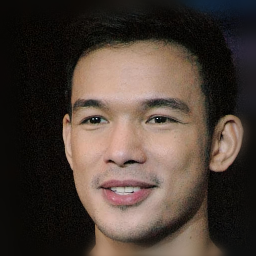

In [18]:
if experiment_type == "ffhq_encode" and 'shape_predictor_68_face_landmarks.dat' not in os.listdir():
    !wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
    !bzip2 -dk shape_predictor_68_face_landmarks.dat.bz2

def run_alignment(image_path):
  import dlib
  from utils.alignment import align_face
  predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
  aligned_image = align_face(filepath=image_path, predictor=predictor)
  print("Aligned image has shape: {}".format(aligned_image.size))
  return aligned_image

if experiment_type == "ffhq_encode":
  input_image = run_alignment(image_path)
else:
  input_image = original_image

input_image.resize(resize_dims)

## Step 6: Perform Inference

In [19]:
img_transforms = EXPERIMENT_ARGS['transform']
transformed_image = img_transforms(input_image)

In [20]:
def display_alongside_source_image(result_image, source_image):
    res = np.concatenate([np.array(source_image.resize(resize_dims)),
                          np.array(result_image.resize(resize_dims))], axis=1)
    return Image.fromarray(res)

def run_on_batch(inputs, net):
    images, latents = net(inputs.to("cuda").float(), randomize_noise=False, return_latents=True)
    if experiment_type == 'cars_encode':
        images = images[:, :, 32:224, :]
    return images, latents

Inference took 1.7820 seconds.


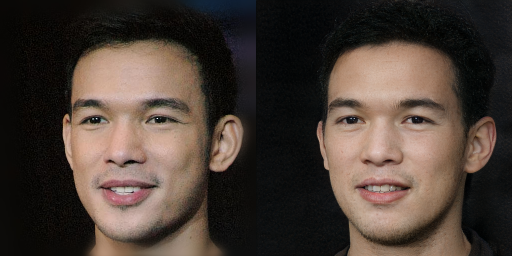

In [21]:
with torch.no_grad():
    tic = time.time()
    images, latents = run_on_batch(transformed_image.unsqueeze(0), net)
    result_image, latent = images[0], latents[0]
    toc = time.time()
    print('Inference took {:.4f} seconds.'.format(toc - tic))

# Display inversion:
display_alongside_source_image(tensor2im(result_image), input_image)

## Edit

In [22]:
from editings import latent_editor
is_cars = experiment_type == 'cars_encode'
editor = latent_editor.LatentEditor(net.decoder, is_cars)

In [23]:
# InterFaceGAN
interfacegan_directions = {
    'ffhq_encode': {
        'age': 'editings/interfacegan_directions/age.pt',
        'smile': 'editings/interfacegan_directions/smile.pt',
        'pose': 'editings/interfacegan_directions/pose.pt'
    }
}
available_interfacegan_directions = None
if experiment_type in interfacegan_directions:  # List supported directions for the current experiment
    available_interfacegan_directions = interfacegan_directions[experiment_type]
    print(list(available_interfacegan_directions.keys()))

['age', 'smile', 'pose']


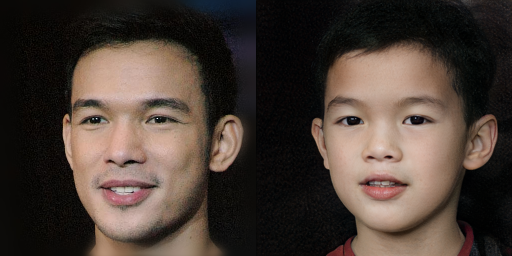

In [24]:
# As an example, we currently released the age and smile directions for the FFHQ StyleGAN Generator.
interfacegan_direction = torch.load(available_interfacegan_directions["age"]).cuda()

# For a single edit:
result = editor.apply_interfacegan(latents, interfacegan_direction, factor=-3).resize(resize_dims)
display_alongside_source_image(result, input_image)

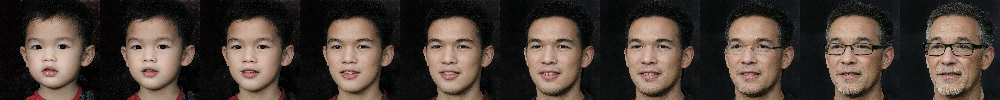

In [25]:
# Or, apply a range of editings
editor.apply_interfacegan(latents, interfacegan_direction, factor_range=(-5, 5))

Available Editings: ['eye_openness', 'smile', 'trimmed_beard', 'white_hair', 'lipstick']


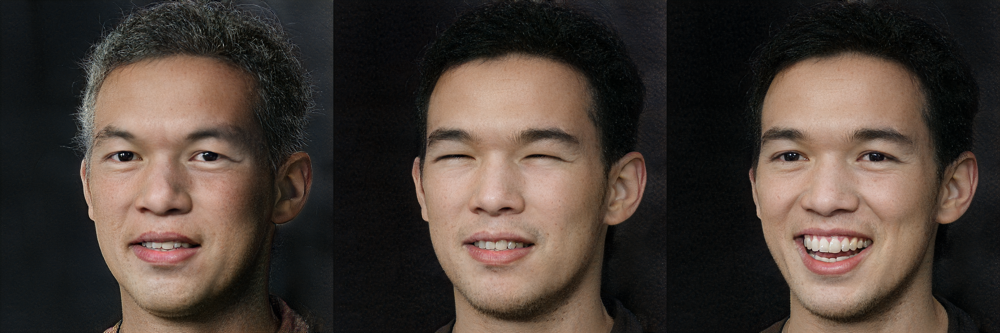

In [26]:
# GANSpace
# Here we provide the editings for the cars domain as displayed in the paper, as well as several examples for the facial domain,
# taken from the official GANSpace repository.
if experiment_type == 'ffhq_encode':
    ganspace_pca = torch.load('editings/ganspace_pca/ffhq_pca.pt')
    directions = {
        'eye_openness':            (54,  7,  8,  20),
        'smile':                   (46,  4,  5, -20),
        'trimmed_beard':           (58,  7,  9,  20),
        'white_hair':              (57,  7, 10, -24),
        'lipstick':                (34, 10, 11,  20)
    }
elif experiment_type == 'cars_encode':
    ganspace_pca = torch.load('editings/ganspace_pca/cars_pca.pt')
    directions = {
        "Viewpoint I": (0, 0, 5, 2),
        "Viewpoint II": (0, 0, 5, -2),
        "Cube": (16, 3, 6, 25),
        "Color": (22, 9, 11, -8),
        "Grass": (41, 9, 11, -18),
    }
print(f'Available Editings: {list(directions.keys())}')
editor.apply_ganspace(latents, ganspace_pca, [directions["white_hair"], directions["eye_openness"], directions["smile"]])

Sample :   0%|          | 0/1 [00:00<?, ?it/s]


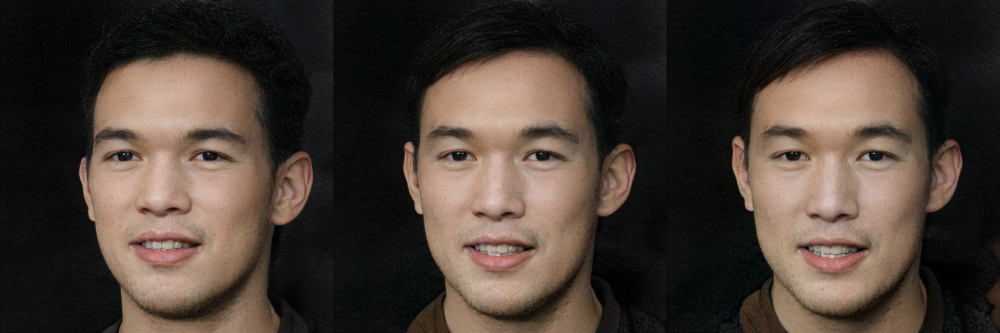

In [27]:
# SeFa
# Note that each model behaves differently to the selected editing parameters.
# We encourage the user to try out different configurations, using different indices, start/end_distance, etc.
# In the paper, we used start and end distance of -15.0, +15.0 over the horses and churches domains.
# See code at editings/sefa.py for further options.
editor.apply_sefa(latents, indices=[2, 3, 4, 5], start_distance=0., end_distance=15.0, step=3)

In [ ]:
# Note, that for Styleflow editings,
# one need to save the output latent codes and load them over the official StyleFlow repository:
# torch.save(latents, 'latents.pt')